# Como usar `latam` (v0.1.2)

En la versión `0.1.2` de `latam` incluimos los atributos `.df` y `.subdivisiones_df` a `Pais`. Estos son DataFrames de `pandas` con la información del país y sus subdivisiones, respectivamente.

En esta versión también se agrega la funcionalidad de acceder al módulo `paises` directamente desde `latam`. Esto significa que puedes hacer
```python
import latam
latam.paises.MEX
>>>> <Pais:México>
```
en lugar de
```python
from latam import paises
paises.MEX
>>>> <Pais:México>
```
si así lo deseas. Ambas maneras funcionan.

In [1]:
import latam

In [3]:
latam.paises.MEX.df

,abrev,alpha_2,alpha_3,capital,capital_horario,capital_lat,capital_long,codigo,es_independiente,es_isla,fecha_independencia,huso_horario,nombre,nombre_comun,nombre_pronunciacion_local,subdivisiones
0,Mex,MX,MEX,Ciudad de México,America/Mexico_City,19.43,-99.13,484,True,False,1810-09-16,"[America/Tijuana, America/Hermosillo, America/...",Estados Unidos Mexicanos,México,'me.xi.ko,"[Aguascalientes, Baja California, Baja Califor..."


In [4]:
latam.paises.MEX.subdivisiones_df

,abrev,capital,capital_horario,capital_lat,capital_long,alpha_2,codigo_numerico,es_contigua,es_isla,fecha_de_fundacion,huso_horario,nombre,nombre_comun,nombre_pronunciacion_local,nombres_nativos
0,AGS,Ciudad de Aguascalientes,America/Mexico_City,21.88,-102.29,AGU,1,True,False,1857-02-05,America/Mexico_City,Aguascalientes,Aguascalientes,a.ɣ̞was.ka'.ljen̟.tes,
1,BC,Mexicali,America/Tijuana,32.67,-115.47,BCN,2,True,False,1952-01-16,America/Tijuana,Baja California,Baja California,'ba.xa. ka.li'.for.nja,
2,BCS,La Paz,America/Hermosillo,24.14,-110.31,BCS,3,True,False,1974-10-08,America/Hermosillo,Baja California Sur,Baja California Sur,'ba.xa. ka.li'.for.nja 'sur,
3,CAM,San Francisco de Campeche,America/Mexico_City,19.85,-90.53,CAM,4,True,False,1863-04-29,America/Mexico_City,Campeche,Campeche,kam'pe.tʃe,
4,CHIS,Tuxtla Gutiérrez,America/Mexico_City,16.75,-93.12,CHP,7,True,False,1824-09-14,America/Mexico_City,Chiapas,Chiapas,tʃjap'.as,
5,CHIH,Chihuahua,America/Chihuahua,28.64,-106.09,CHH,8,True,False,1824-07-06,America/Chihuahua,Chihuahua,Chihuahua,tʃi'.wa.wa,
6,COAH,Saltillo,America/Chihuahua,25.43,-101.00,COA,5,True,False,1824-05-07,America/Chihuahua,Coahuila de Zaragoza,Coahuila,koa'.wj.la ðe θa.ra'.ɣ̞o.θa,
7,COL,Colima,America/Mexico_City,19.24,-103.73,COL,6,True,False,1856-12-09,America/Mexico_City,Colima,Colima,ko'.li.ma,
8,DUR,Victoria de Durango,America/Mexico_City,24.02,-104.67,DUR,10,True,False,1824-05-22,America/Mexico_City,Durango,Durango,du'.ɾaŋ.ɡo,"Korian (Tepehuán),Tepēhuahcān (Náhuatl)"
9,GTO,Guanajuato,America/Mexico_City,21.02,-101.26,GUA,11,True,False,1823-12-20,America/Mexico_City,Guanajuato,Guanajuato,gwa.na'.xwa.to,kuanhasï juáta (Purépecha)


Aquí puedes ver todos los atributos de cada `Subdivision` del `Pais` México.

Cada `Subdivision` tiene el atributo `.codigo` y `.codigo_numerico` (las columnas `alpha_2` y `codigo_numerico`, respectivamente). El código (o `alpha_2` esta basado en la norma [ISO-3611-2](https://es.wikipedia.org/wiki/ISO_3166-2) para las subdivisiones y [ISO-3611-1](https://es.wikipedia.org/wiki/ISO_3166-1) para los paises. Esto significa que puedes utilizar este DataFrame para mezclar, filtrar, manipular otros datos de fuentes oficiales o que utilizen la norma. Por ejemplo,

In [5]:
import geopandas as gpd

<AxesSubplot:>

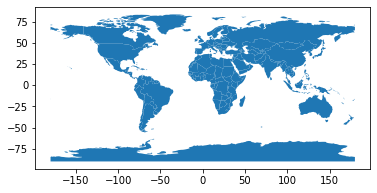

In [10]:
datos_geopandas = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))
datos_geopandas.plot()

<AxesSubplot:>

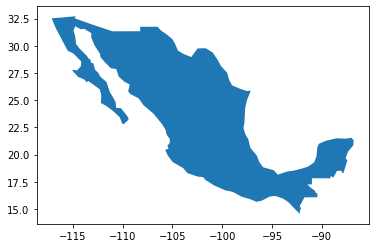

In [12]:
mask_paises_en_mis_datos = datos_geopandas['iso_a3'].isin(latam.paises.MEX.df['alpha_3'])
datos_geopandas[mask_paises_en_mis_datos].plot()

## IPUMS
Ah, como amo IPUMS. IPUMS originalmente era un acrónimo de **Integrated Public Use Microdata Series** y era un proyecto de la universidad de Minesota que homologa datos del censo para **integrarlos** en un conjunto de datos facil de usar. Este proyecto se expandio a crear otras ramas como IPUMS-International (*internacional*, en inglés :p) el cual homologa datos censales de muchos paises y también ofrecen datos geográficos. Puedes visitar su página en <https://international.ipums.org>.

In [13]:
from zipfile import ZipFile

In [15]:
!wget https://international.ipums.org/international/resources/gis/world_geolev1_2019.zip

--2020-10-15 16:42:47--  https://international.ipums.org/international/resources/gis/world_geolev1_2019.zip
Resolving international.ipums.org (international.ipums.org)... 128.101.163.164
Connecting to international.ipums.org (international.ipums.org)|128.101.163.164|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 235596678 (225M) [application/zip]
Saving to: ‘world_geolev1_2019.zip’

world_geolev1_2019. 100%[===================>] 224.68M  6.80MB/s    in 35s     

2020-10-15 16:43:23 (6.36 MB/s) - ‘world_geolev1_2019.zip’ saved [235596678/235596678]



In [16]:
ZipFile("./world_geolev1_2019.zip").extractall()

<AxesSubplot:>

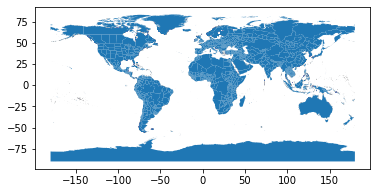

In [18]:
mundo = gpd.read_file("world_geolev1_2019.shp")
mundo.plot()

Aquí puedes ver con mas detalle que datos incluye. Cada fila de este geodataframe es una poligono para una _subdivisión_. La entidad subnacional del país. En México son _estados_ en otros países pueden conocerse como distritos, provincias, territorios, etc.

In [21]:
mundo.sample(5)

,CNTRY_NAME,ADMIN_NAME,CNTRY_CODE,GEOLEVEL1,BPL_CODE,geometry
1219,Philippines,Nueva Ecija,608,608049,33080.0,"POLYGON ((121.28172 15.77052, 121.28737 15.753..."
289,Cook Is.,None,184,None,54010.0,"MULTIPOLYGON (((-157.91502 -21.87544, -157.914..."
742,Ireland,Border,372,372001,42060.0,"MULTIPOLYGON (((-6.09756 54.01247, -6.10008 54..."
1778,Uganda,Gulu,800,800304,11160.0,"POLYGON ((32.19866 3.50607, 32.19864 3.50599, ..."
112,Brazil,Alagoas,076,076027,23030.0,"MULTIPOLYGON (((-36.42128 -10.47667, -36.42170..."


Si ves la documentación el `CNTRY_CODE` es el código numérico de cada país (basado en ISO-3611-1) y el `GEOLEVEL1` es el ISO-3611-2. Así que podemos utilizar `latam` para obtener solo los polígonos de nuestro país.

In [23]:
mask_mexico = mundo['CNTRY_CODE'].isin(latam.paises.MEX.df['codigo'])
mundo[mask_mexico]

,CNTRY_NAME,ADMIN_NAME,CNTRY_CODE,GEOLEVEL1,BPL_CODE,geometry
924,Mexico,Aguascalientes,484,484001,22060.0,"POLYGON ((-102.28777 22.41637, -102.28753 22.4..."
925,Mexico,Baja California,484,484002,22060.0,"MULTIPOLYGON (((-114.13834 28.00211, -114.1383..."
926,Mexico,Baja California Sur,484,484003,22060.0,"MULTIPOLYGON (((-109.80419 22.94320, -109.8058..."
927,Mexico,Campeche,484,484004,22060.0,"MULTIPOLYGON (((-92.01303 18.54842, -92.01405 ..."
928,Mexico,Coahuila de Zaragoza,484,484005,22060.0,"POLYGON ((-102.31415 29.87936, -102.31353 29.8..."
929,Mexico,Colima,484,484006,22060.0,"MULTIPOLYGON (((-114.76717 18.37683, -114.7638..."
930,Mexico,Chiapas,484,484007,22060.0,"POLYGON ((-91.97364 17.91143, -91.96993 17.910..."
931,Mexico,Chihuahua,484,484008,22060.0,"POLYGON ((-106.51767 31.77173, -106.51712 31.7..."
932,Mexico,Distrito Federal,484,484009,22060.0,"POLYGON ((-99.11124 19.56150, -99.11421 19.558..."
933,Mexico,Durango,484,484010,22060.0,"POLYGON ((-105.96732 26.78554, -105.93919 26.7..."


Y como pueden ver el `GEOLEVEL1` es una combinación de 6 dígitos. Los primeros 3 son el código del país y los últimos 3 son de la subdivisión. Se tienen que ser 6 caracteres así que si el código de tu subdivisión es 1 tienes que cambiarlo a 001.

In [53]:
estados_mx = latam.paises.MEX.subdivisiones_df.copy()

In [54]:
estados_mx['codigo_numerico'] = estados_mx['codigo_numerico'].astype(str).str.zfill(3)

In [55]:
estados_mx.head()

,abrev,capital,capital_horario,capital_lat,capital_long,alpha_2,codigo_numerico,es_contigua,es_isla,fecha_de_fundacion,huso_horario,nombre,nombre_comun,nombre_pronunciacion_local,nombres_nativos
0,AGS,Ciudad de Aguascalientes,America/Mexico_City,21.88,-102.29,AGU,001,True,False,1857-02-05,America/Mexico_City,Aguascalientes,Aguascalientes,a.ɣ̞was.ka'.ljen̟.tes,
1,BC,Mexicali,America/Tijuana,32.67,-115.47,BCN,002,True,False,1952-01-16,America/Tijuana,Baja California,Baja California,'ba.xa. ka.li'.for.nja,
2,BCS,La Paz,America/Hermosillo,24.14,-110.31,BCS,003,True,False,1974-10-08,America/Hermosillo,Baja California Sur,Baja California Sur,'ba.xa. ka.li'.for.nja 'sur,
3,CAM,San Francisco de Campeche,America/Mexico_City,19.85,-90.53,CAM,004,True,False,1863-04-29,America/Mexico_City,Campeche,Campeche,kam'pe.tʃe,
4,CHIS,Tuxtla Gutiérrez,America/Mexico_City,16.75,-93.12,CHP,007,True,False,1824-09-14,America/Mexico_City,Chiapas,Chiapas,tʃjap'.as,


In [56]:
estados_mx['GEOLEVEL1'] = "484" + estados_mx['codigo_numerico']

In [57]:
estados_mx.head()

,abrev,capital,capital_horario,capital_lat,capital_long,alpha_2,codigo_numerico,es_contigua,es_isla,fecha_de_fundacion,huso_horario,nombre,nombre_comun,nombre_pronunciacion_local,nombres_nativos,GEOLEVEL1
0,AGS,Ciudad de Aguascalientes,America/Mexico_City,21.88,-102.29,AGU,001,True,False,1857-02-05,America/Mexico_City,Aguascalientes,Aguascalientes,a.ɣ̞was.ka'.ljen̟.tes,,484001
1,BC,Mexicali,America/Tijuana,32.67,-115.47,BCN,002,True,False,1952-01-16,America/Tijuana,Baja California,Baja California,'ba.xa. ka.li'.for.nja,,484002
2,BCS,La Paz,America/Hermosillo,24.14,-110.31,BCS,003,True,False,1974-10-08,America/Hermosillo,Baja California Sur,Baja California Sur,'ba.xa. ka.li'.for.nja 'sur,,484003
3,CAM,San Francisco de Campeche,America/Mexico_City,19.85,-90.53,CAM,004,True,False,1863-04-29,America/Mexico_City,Campeche,Campeche,kam'pe.tʃe,,484004
4,CHIS,Tuxtla Gutiérrez,America/Mexico_City,16.75,-93.12,CHP,007,True,False,1824-09-14,America/Mexico_City,Chiapas,Chiapas,tʃjap'.as,,484007


In [58]:
mexico_geo = mundo[mask_mexico]

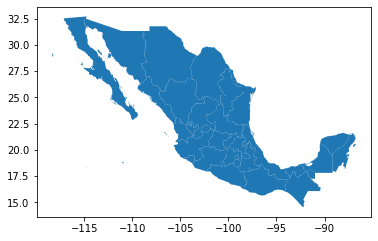

In [59]:
estados_mx_geo = gpd.GeoDataFrame(estados_mx.merge(mexico_geo[['GEOLEVEL1', 'geometry']], on = "GEOLEVEL1", how='left'))
estados_mx_geo.plot();

## Bonus:

In [60]:
import altair as alt

In [64]:
estados_mx_geo_slim = estados_mx_geo[['nombre', 'fecha_de_fundacion', 'geometry']].copy()
estados_mx_geo_slim['fecha_de_fundacion'] = estados_mx_geo_slim['fecha_de_fundacion'].astype(str)

In [67]:
alt.Chart(estados_mx_geo_slim).mark_geoshape().encode(
    tooltip = alt.Tooltip(['nombre', 'fecha_de_fundacion'])
).properties(
    width = 700,
)

alt.Chart(...)